In [1]:
import numpy as np
import seaborn as sns
import torch

import umap
import matplotlib.pyplot as plt
import pandas as pd
from community import community_louvain
from torch_geometric.utils import k_hop_subgraph,to_networkx,from_networkx
import matplotlib

import utils
import plots
from model_AE import reduction_AE
from model_GAT import Encoder,SenGAE,train_GAT
from model_Sencell import Sencell

# Part 1: load and process data
data_path="/users/PCON0022/haocheng/Basu_lab/rmarkdown/SCB01S5.h5ad"
# cell_cluster_arr在画umap的时候用
adata,cluster_cell_ls,cell_cluster_arr,celltype_names=utils.load_data(data_path)
# plots.umapPlot(adata.obsm['X_umap'],clusters=cell_cluster_arr,labels=celltype_names)

new_data,markers_index,\
sen_gene_ls,nonsen_gene_ls,gene_names=utils.process_data(adata,cluster_cell_ls,cell_cluster_arr)

print(f'cell num: {new_data.shape[0]}, gene num: {new_data.shape[1]}')

gene_cell=new_data.X.toarray().T
graph_nx=utils.build_graph_nx(gene_cell,cell_cluster_arr,sen_gene_ls,nonsen_gene_ls,gene_names)
print("Part 1, data loading and processing end!")

# Part 2: generate init embedding
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print('device: ',device)

retrain=False
if retrain:
    gene_embed,cell_embed=reduction_AE(gene_cell,device)
    print(gene_embed.shape,cell_embed.shape)
    torch.save(gene_embed,'./gene.emb')
    torch.save(cell_embed,'./cell.emb')
else:
    gene_embed=torch.load('./gene.emb')
    cell_embed=torch.load('./cell.emb')

graph_nx=utils.add_nx_embedding(graph_nx,gene_embed,cell_embed)
graph_pyg=utils.build_graph_pyg(gene_cell,gene_embed,cell_embed)
print("Part 2, AE end!")

# Part 3: train GAT
# graph_pyg=graph_pyg.to('cpu')
GAT_model=train_GAT(graph_nx,graph_pyg,device,retrain=False,resampling=False)
print("Part 3, training GAT end!")



from sampling import identify_sencell_marker_graph
from sampling import sub_sampling_by_random
from model_Sencell import cell_optim,update_cell_embeddings,old_cell_optim

from sampling import identify_sengene_then_sencell


all_gene_ls=[]

list_sencell_cover=[]
list_sengene_cover=[]

def get_sencell_cover(old_sencell_dict,sencell_dict):
    set1=set(list(old_sencell_dict.keys()))
    set2=set(list(sencell_dict.keys()))
    set3=set1.intersection(set2)
    print('sencell cover:',len(set3)/len(set2))
    
    return len(set3)/len(set2)

def get_sengene_cover(old_sengene_ls,sengene_ls):
    set1=set(old_sengene_ls)
    set2=set(sengene_ls)
    set3=set1.intersection(set2)
    print('sengene cover:',len(set3)/len(set2))
    
    return len(set3)/len(set2)
    
    
cellmodel=Sencell().to(device)
optimizer = torch.optim.Adam(cellmodel.parameters(), lr=0.001, 
                                weight_decay=1e-3)

for marker_index in markers_index:
#     sampled_graph,sencell_dict,nonsencell_dict,cell_clusters,big_graph_index_dict,sengene_ls=sub_sampling_by_random(graph_nx,graph,
#                                                             sen_gene_ls,
#                                                             nonsen_gene_ls,
#                                                             GAT_model,
#                                                             device,
#                                                             marker_index,
#                                                             n_gene=200,                                                        
#                                                             gene_num=2245,cell_num=10558,
#                                                             gene_rate=0.3,cell_rate=0.5,
#                                                             debug=False)
    
    sampled_graph,sencell_dict,nonsencell_dict,cell_clusters,big_graph_index_dict=sub_sampling_by_random(graph_nx,
                                                            sen_gene_ls,
                                                            nonsen_gene_ls,
                                                            GAT_model,
                                                            device,
                                                            marker_index,
                                                            n_gene=200,                                                        
                                                            gene_num=2245,cell_num=10558,
                                                            gene_rate=0.3,cell_rate=0.5,
                                                            debug=False)
    old_sengene_indexs=marker_index
    for epoch in range(10):
        print("epoch:",epoch)
        old_sencell_dict=sencell_dict
        cellmodel,sencell_dict,nonsencell_dict=cell_optim(cellmodel,optimizer,
                                                          sencell_dict,nonsencell_dict,device,
                                                         train=True)
        sampled_graph=update_cell_embeddings(sampled_graph,sencell_dict,nonsencell_dict)
        sencell_dict,nonsencell_dict, \
        sen_gene_indexs,nonsen_gene_indexs=identify_sengene_then_sencell(sampled_graph,GAT_model,
                                                                      sencell_dict,nonsencell_dict,device,
                                                                      cell_clusters,
                                                                      big_graph_index_dict,
                                                                      len(marker_index))
        
        get_sencell_cover(old_sencell_dict,sencell_dict)
        get_sengene_cover(old_sengene_indexs,sen_gene_indexs)
        old_sengene_indexs=sen_gene_indexs
    break

cluster 数量： 21
celltype names: ['Macrophages', 'T cell lineage', 'Unknown', 'B cell lineage', 'Innate lymphoid cell NK', 'AT2', 'Monocytes', 'Multiciliated lineage', 'Dendritic cells', 'EC capillary', 'Mast cells', 'Fibroblasts', 'Secretory', 'EC venous', 'Lymphatic EC mature', 'AT1', 'Basal', 'EC arterial', 'Myofibroblasts', 'None', 'Submucosal Secretory']
-----------------------  ----
Macrophages              6941
T cell lineage            749
Unknown                   618
B cell lineage            374
Innate lymphoid cell NK   327
AT2                       294
Monocytes                 228
Multiciliated lineage     194
Dendritic cells           177
EC capillary              138
Mast cells                100
Fibroblasts                93
Secretory                  86
EC venous                  74
Lymphatic EC mature        68
AT1                        27
Basal                      26
EC arterial                20
Myofibroblasts             17
None                        6
Submucosal

In [57]:
print(len(marker_index))
intersections=set(marker_index).intersection(set(sen_gene_indexs))
print(len(intersections))


114
49


In [59]:
cluster_cell_dict={}
gene_num=2245
cell_cluster_ls=[v[1] for k,v in sencell_dict.items()]
cell_index_ls=[v[3]-gene_num for k,v in sencell_dict.items()]
for cluster,index in zip(cell_cluster_ls,cell_index_ls):
    if cluster in cluster_cell_dict:
        cluster_cell_dict[cluster].append(index)
    else:
        cluster_cell_dict[cluster]=[index]
          

In [60]:
cluster_cell_dict[5]

[5606, 1194, 3307, 2667, 4042]

In [91]:
outputs_dict={}
total_genes=set()
for key,value in cluster_cell_dict.items():
    print(f'cluster: {key}')
    gene_ls=[]
    for cell_index in value:
        gene_ls.append([i for i in graph_nx.neighbors(cell_index+gene_num)])
    # 这个cluster内部所有cell的基因先取交集
    results=set()
    for j in gene_ls:
        if len(results)==0:
            results=set(j)
        else:
            results=results.intersection(set(j))
    
    results=results.intersection(set(sen_gene_indexs))
    results=[gene_names[i] for i in results]
    total_genes.update(results)
    outputs_dict[key]=sorted(results)

cluster: 11
cluster: 5
cluster: 2
cluster: 8
cluster: 18
cluster: 17
cluster: 19
cluster: 9
cluster: 13


In [94]:
rows=sorted(list(total_genes))
cols=sorted(list(outputs_dict.keys()))
cols

[2, 5, 8, 9, 11, 13, 17, 18, 19]

In [96]:
matrix=np.zeros((51,9))

for col_index in range(9):
    cluster=cols[col_index]
    genes=outputs_dict[cluster]
    for gene in genes:
        row_index=rows.index(gene)
        matrix[row_index][col_index]=1
        

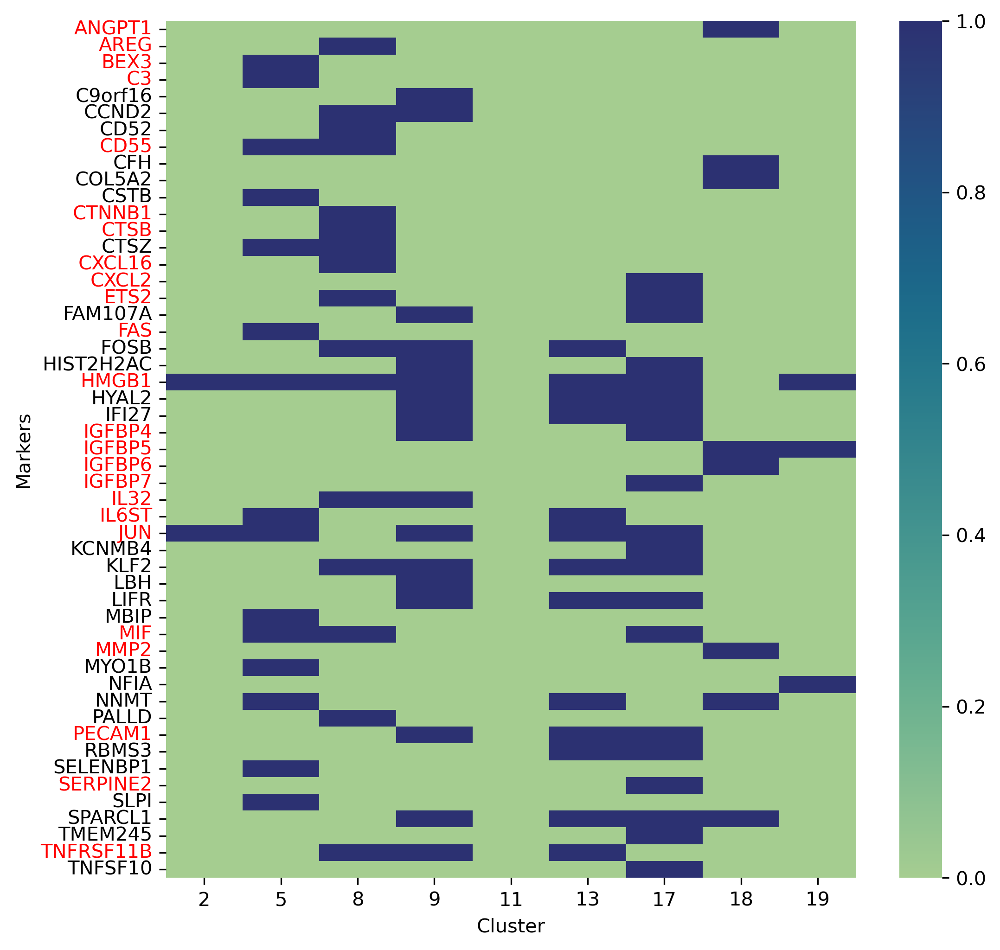

In [119]:
plt.figure(figsize=(8,8),dpi=300)

ax=sns.heatmap(matrix, cmap="crest",xticklabels=cols,yticklabels=rows)
plt.ylabel('Markers')
plt.xlabel("Cluster")
# plt.get_ticklines()
for i in indexs:
    ax.get_yticklabels()[i].set_color("red") 

In [121]:
matrix[:,4]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

In [120]:
indexs=[]
marker_index_names=[gene_names[i] for i in marker_index]
for j,i in enumerate(rows):
    if i in marker_index_names:
        indexs.append(j)
        print(i)



ANGPT1
AREG
BEX3
C3
CD55
CTNNB1
CTSB
CXCL16
CXCL2
ETS2
FAS
HMGB1
IGFBP4
IGFBP5
IGFBP6
IGFBP7
IL32
IL6ST
JUN
MIF
MMP2
PECAM1
SERPINE2
TNFRSF11B


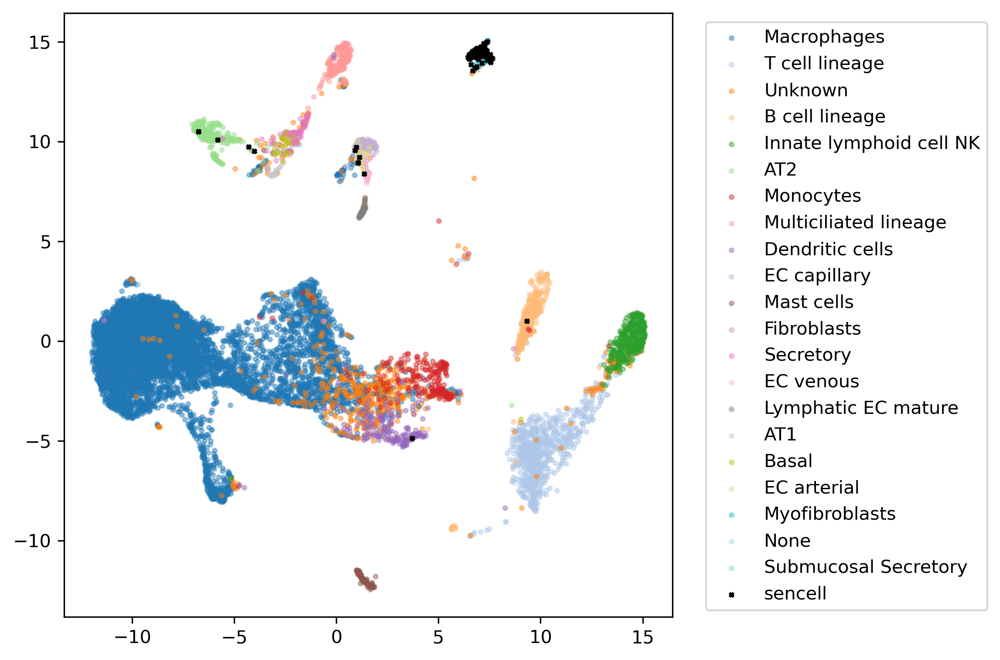

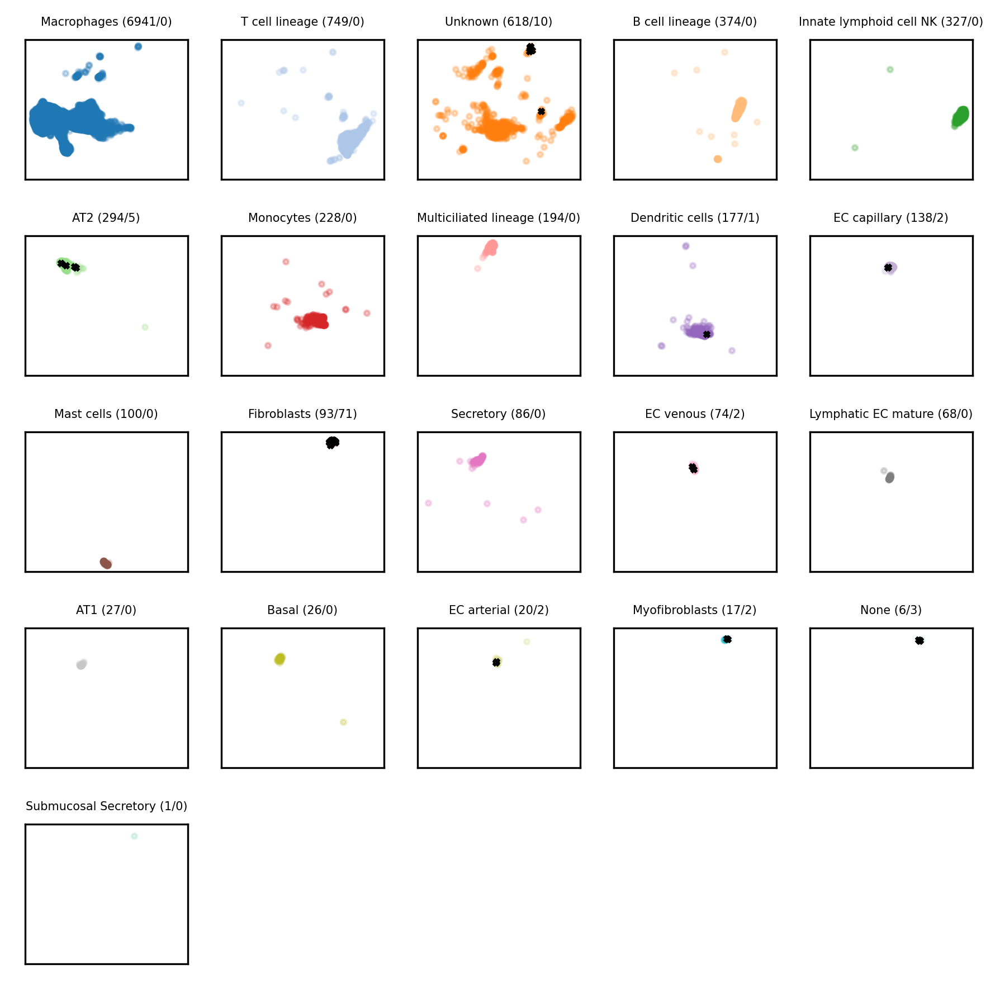

In [51]:
def umapPlot(embedding,cell_index_ls,clusters=None,reduce=False,labels=None):
    # if tensor: embedding should be .cpu().detach()
    # clusters: Nxt
    # t里面存的是行的index
    if reduce:
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(embedding)
    
    plt.figure(figsize=(6,6),dpi=300)
    cmap1 = matplotlib.cm.get_cmap('tab20')        
    cmap2 = matplotlib.cm.get_cmap('Set3')  
    color_ls=cmap1.colors+cmap2.colors
    if clusters is None:
        plt.scatter(embedding[:,0],embedding[:,1],alpha=0.5,s=5)
    else:
        for i,(cluster,label) in enumerate(zip(clusters,labels)):
            plt.scatter(embedding[cluster,0],embedding[cluster,1],alpha=0.4,s=5,color=color_ls[i],label=label)
            
        plt.scatter(embedding[cell_index_ls,0],embedding[cell_index_ls,1],s=5,color='black',marker='x',label='sencell')
        plt.legend(bbox_to_anchor=(1.04, 1), loc="upper left")

def subUmapPlot(embedding,clusters=None,reduce=False,labels=None):
    # if tensor: embedding should be .cpu().detach()
    # clusters: Nxt
    # t里面存的是行的index
    if reduce:
        reducer = umap.UMAP()
        embedding = reducer.fit_transform(embedding)
    
    fig, axes = plt.subplots(5, 5, sharex=True, sharey=True,figsize=(6,6),dpi=300)

    cmap1 = matplotlib.cm.get_cmap('tab20')        
    cmap2 = matplotlib.cm.get_cmap('Set3')  
    color_ls=cmap1.colors+cmap2.colors
    if clusters is None:
        plt.scatter(embedding[:,0],embedding[:,1],alpha=0.5,s=5)
    else:
        x_s=[]
        y_s=[]
        label_s=[]
        for cluster,label in zip(clusters,labels):
            x_s.append(embedding[cluster,0])
            y_s.append(embedding[cluster,1])
            label_s.append(label)
        count=0
        for i, row in enumerate(axes):
            for j, col in enumerate(row):
                if count<21:
                    col.scatter(x_s[count],y_s[count],alpha=0.25,color=color_ls[count],s=5)
                    sencell_num=0
                    if count in cluster_cell_dict:
                        # 这一簇有老化细胞
                        col.scatter(embedding[cluster_cell_dict[count],0],embedding[cluster_cell_dict[count],1],
                                   s=5,color='black',marker='x',label='sencell')
                        sencell_num=len(cluster_cell_dict[count])
                        
                    col.set_title(f"{label_s[count]} ({len(clusters[count])}/{sencell_num})",fontsize=5)
                    count+=1
                else:
                    col.set_visible(False)
    plt.setp(fig.axes, yticks=[],xticks=[])
    
    plt.tight_layout()

        
umapPlot(adata.obsm['X_umap'],np.array(cell_index_ls),clusters=cluster_cell_ls,labels=celltype_names)
subUmapPlot(adata.obsm['X_umap'],clusters=cluster_cell_ls,labels=celltype_names)

In [7]:
s="""
epoch: 0
67.96671295166016
62.180965423583984
53.394996643066406
42.638729095458984
41.7903938293457
46.96113967895508
44.7690315246582
40.694087982177734
39.42652130126953
40.59672927856445
41.494590759277344
40.87733459472656
39.37166976928711
37.87919616699219
37.10112762451172
37.258331298828125
37.663692474365234
37.30532455444336
36.06500244140625
34.60651779174805
rechoice sengene num: 114 rechoice nonsengene num: 200
    Sencell num: 75, Nonsencell num: 750
sencell cover: 0.4666666666666667
sengene cover: 0.43859649122807015
epoch: 1
22.799509048461914
22.670001983642578
22.31853675842285
21.74652862548828
20.954486846923828
19.90408706665039
18.641407012939453
17.38115692138672
16.655420303344727
16.594873428344727
17.071401596069336
17.726085662841797
18.22231101989746
18.319244384765625
18.020790100097656
17.467674255371094
16.895387649536133
16.443342208862305
16.219160079956055
16.18752098083496
rechoice sengene num: 114 rechoice nonsengene num: 200
    Sencell num: 100, Nonsencell num: 1000
sencell cover: 0.74
sengene cover: 0.8157894736842105
epoch: 2
21.20742416381836
21.394386291503906
21.438398361206055
21.282562255859375
20.95746421813965
20.545812606811523
20.2098388671875
20.03508758544922
19.973146438598633
19.96249771118164
19.882272720336914
19.710596084594727
19.489030838012695
19.30447006225586
19.22707748413086
19.24244499206543
19.273773193359375
19.294469833374023
19.29296875
19.273666381835938
rechoice sengene num: 114 rechoice nonsengene num: 200
    Sencell num: 98, Nonsencell num: 980
sencell cover: 1.0
sengene cover: 0.9649122807017544
epoch: 3
19.52153968811035
19.397241592407227
19.26079559326172
19.131677627563477
19.0306453704834
18.970027923583984
18.949689865112305
18.943748474121094
18.90398406982422
18.80837059020996
18.683753967285156
18.60022735595703
18.578353881835938
18.576398849487305
18.563549041748047
18.524799346923828
18.470779418945312
18.421274185180664
18.388940811157227
18.36473846435547
rechoice sengene num: 114 rechoice nonsengene num: 200
    Sencell num: 100, Nonsencell num: 1000
sencell cover: 0.98
sengene cover: 0.9912280701754386
epoch: 4
18.55078125
18.39742088317871
18.22223472595215
18.155197143554688
18.152542114257812
18.133703231811523
18.08071517944336
18.00834083557129
17.928579330444336
17.857980728149414
17.81314468383789
17.79050064086914
17.747175216674805
17.66493797302246
17.564754486083984
17.479167938232422
17.406461715698242
17.336978912353516
17.257369995117188
17.173852920532227
rechoice sengene num: 114 rechoice nonsengene num: 200
    Sencell num: 100, Nonsencell num: 1000
sencell cover: 0.99
sengene cover: 0.9824561403508771
epoch: 5
17.03367042541504
16.927682876586914
16.8001651763916
16.645771026611328
16.466428756713867
16.25139808654785
15.98417854309082
15.643269538879395
15.205321311950684
14.647589683532715
13.981541633605957
13.510807991027832
13.733400344848633
14.206517219543457
14.331761360168457
13.98862075805664
13.525171279907227
13.35814094543457
13.495640754699707
13.575048446655273
rechoice sengene num: 114 rechoice nonsengene num: 200
    Sencell num: 98, Nonsencell num: 980
sencell cover: 1.0
sengene cover: 1.0
epoch: 6
13.444210052490234
13.374017715454102
13.289432525634766
13.230676651000977
13.171003341674805
13.096213340759277
13.038175582885742
12.99930477142334
12.995073318481445
12.987959861755371
12.971400260925293
12.924660682678223
12.840084075927734
12.757516860961914
12.741382598876953
12.775652885437012
12.77638053894043
12.721945762634277
12.649576187133789
12.617091178894043
rechoice sengene num: 114 rechoice nonsengene num: 200
    Sencell num: 98, Nonsencell num: 980
sencell cover: 1.0
sengene cover: 0.9824561403508771
epoch: 7
12.684971809387207
12.679719924926758
12.639326095581055
12.590883255004883
12.551523208618164
12.539628982543945
12.539702415466309
12.526406288146973
12.49551010131836
12.454056739807129
12.422124862670898
12.41387939453125
12.412073135375977
12.396576881408691
12.366097450256348
12.339540481567383
12.32597827911377
12.318464279174805
12.305493354797363
12.286271095275879
rechoice sengene num: 114 rechoice nonsengene num: 200
    Sencell num: 98, Nonsencell num: 980
sencell cover: 1.0
sengene cover: 1.0
epoch: 8
12.290515899658203
12.284029006958008
12.269379615783691
12.250570297241211
12.235291481018066
12.226310729980469
12.220230102539062
12.20504093170166
12.188885688781738
12.17656421661377
12.166238784790039
12.154582023620605
12.141026496887207
12.129940032958984
12.117795944213867
12.103372573852539
12.091495513916016
12.081059455871582
12.069978713989258
12.057719230651855
rechoice sengene num: 114 rechoice nonsengene num: 200
    Sencell num: 98, Nonsencell num: 980
sencell cover: 1.0
sengene cover: 1.0
epoch: 9
12.043899536132812
12.030513763427734
12.018248558044434
12.006922721862793
11.994046211242676
11.982098579406738
11.970840454101562
11.95926570892334
11.947591781616211
11.934861183166504
11.925692558288574
11.913402557373047
11.900751113891602
11.889334678649902
11.876955032348633
11.864768028259277
11.854434967041016
11.842216491699219
11.830772399902344
11.819620132446289
rechoice sengene num: 114 rechoice nonsengene num: 200
    Sencell num: 98, Nonsencell num: 980
sencell cover: 1.0
sengene cover: 1.0
"""

In [14]:
contents=s.split("\n")
sencell_covers=[]
sengene_covers=[]

epoch_loss=[]
for i,j in enumerate(contents):
    if 'epoch' in j:
        loss=contents[i+1:i+21]
        epoch_loss.append([float(k) for k in loss])
    if 'sencell cover' in j:
        sencell_covers.append(float(j.split(':')[-1]))
    if 'sengene cover' in j:
        sengene_covers.append(float(j.split(':')[-1]))

Text(0.5, 0, 'Iterations')

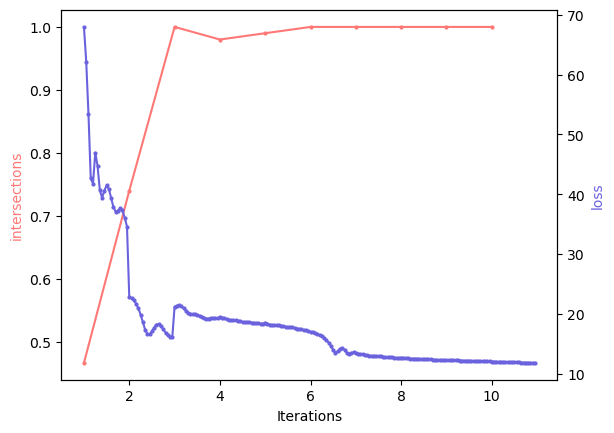

In [34]:
l1=plt.plot(1+np.arange(len(sencell_covers)),sencell_covers,marker='o',c='#fe7876',markersize=2,label='intersections')
plt.ylabel('intersections',color='#fe7876')
plt.xlabel('Iterations')
x_s=[]
for i in range(1,11):
    x_s.append(np.linspace(i, i+1, num=20, endpoint=False))
    
x_s=np.concatenate(x_s)
plt.twinx()
l2=plt.plot(x_s,np.concatenate(epoch_loss),marker='o',c='#6b62dd',markersize=2,label='loss')
plt.ylabel('loss',color='#6b62dd')
plt.xlabel('Iterations')


# lns = l1+l2
# labs = [l.get_label() for l in lns]
# plt.legend(lns, labs, loc=2)

array([ 1.  ,  1.05,  1.1 ,  1.15,  1.2 ,  1.25,  1.3 ,  1.35,  1.4 ,
        1.45,  1.5 ,  1.55,  1.6 ,  1.65,  1.7 ,  1.75,  1.8 ,  1.85,
        1.9 ,  1.95,  2.  ,  2.05,  2.1 ,  2.15,  2.2 ,  2.25,  2.3 ,
        2.35,  2.4 ,  2.45,  2.5 ,  2.55,  2.6 ,  2.65,  2.7 ,  2.75,
        2.8 ,  2.85,  2.9 ,  2.95,  3.  ,  3.05,  3.1 ,  3.15,  3.2 ,
        3.25,  3.3 ,  3.35,  3.4 ,  3.45,  3.5 ,  3.55,  3.6 ,  3.65,
        3.7 ,  3.75,  3.8 ,  3.85,  3.9 ,  3.95,  4.  ,  4.05,  4.1 ,
        4.15,  4.2 ,  4.25,  4.3 ,  4.35,  4.4 ,  4.45,  4.5 ,  4.55,
        4.6 ,  4.65,  4.7 ,  4.75,  4.8 ,  4.85,  4.9 ,  4.95,  5.  ,
        5.05,  5.1 ,  5.15,  5.2 ,  5.25,  5.3 ,  5.35,  5.4 ,  5.45,
        5.5 ,  5.55,  5.6 ,  5.65,  5.7 ,  5.75,  5.8 ,  5.85,  5.9 ,
        5.95,  6.  ,  6.05,  6.1 ,  6.15,  6.2 ,  6.25,  6.3 ,  6.35,
        6.4 ,  6.45,  6.5 ,  6.55,  6.6 ,  6.65,  6.7 ,  6.75,  6.8 ,
        6.85,  6.9 ,  6.95,  7.  ,  7.05,  7.1 ,  7.15,  7.2 ,  7.25,
        7.3 ,  7.35,

In [3]:
from sampling import identify_sencell_marker_graph
from sampling import sub_sampling_by_random
from model_Sencell import cell_optim,update_cell_embeddings,old_cell_optim

from sampling import identify_sengene_by_sencell


all_gene_ls=[]

list_sencell_cover=[]
list_sengene_cover=[]


    
cellmodel=Sencell().to(device)

for marker_index in markers_index:
#     sampled_graph,sencell_dict,nonsencell_dict,cell_clusters,big_graph_index_dict,sengene_ls=sub_sampling_by_random(graph_nx,graph,
#                                                             sen_gene_ls,
#                                                             nonsen_gene_ls,
#                                                             GAT_model,
#                                                             device,
#                                                             marker_index,
#                                                             n_gene=200,                                                        
#                                                             gene_num=2245,cell_num=10558,
#                                                             gene_rate=0.3,cell_rate=0.5,
#                                                             debug=False)
    
    sampled_graph,cell_clusters,big_graph_index_dict=sub_sampling_by_random(graph_nx,
                                                            sen_gene_ls,
                                                            nonsen_gene_ls,
                                                            GAT_model,
                                                            device,
                                                            marker_index,
                                                            n_gene=200,                                                        
                                                            gene_num=2245,cell_num=10558,
                                                            gene_rate=0.3,cell_rate=0.5,
                                                            debug=False)
    break
    

    # print('After sampling, gene num: ',sum(sampled_graph.y))
    # print(sengene_ls)
    sencell_cover=[]
    sengene_cover=[]
    iter_sengene_ls=[]
    
    for _ in range(10):
        # print(sencell_dict,nonsencell_dict)

        sencell_dict,nonsencell_dict=old_cell_optim(sencell_dict,nonsencell_dict,device)
        # print(sencell_dict,nonsencell_dict)
        sampled_graph=update_cell_embeddings(sampled_graph,sencell_dict,nonsencell_dict)
        old_sencell_dict=sencell_dict
        old_sengene_ls=sengene_ls
        iter_sengene_ls.append(old_sengene_ls)
        sampled_graph,sencell_dict,nonsencell_dict,cell_clusters,big_graph_index_dict,sengene_ls=identify_sengene_by_sencell(sampled_graph,GAT_model,cell_clusters,
                                  big_graph_index_dict,
                                  sencell_dict,
                                  nonsencell_dict,device)
        print('After sampling, gene num: ',sum(sampled_graph.y))


        set1=set(list(old_sencell_dict.keys()))
        set2=set(list(sencell_dict.keys()))
        set3=set1.intersection(set2)
        print('sencell cover:',len(set3)/len(set2))
        sencell_cover.append(len(set3)/len(set2))
        
        set1=set(old_sengene_ls)
        set2=set(sengene_ls)
        set3=set1.intersection(set2)
        print('sengene cover:',len(set3)/len(set2))
        sengene_cover.append(len(set3)/len(set2))
    
    list_sencell_cover.append(sencell_cover)
    list_sengene_cover.append(sengene_cover)
    
    all_gene_ls.append(iter_sengene_ls)
    
    break

Start sampling subgraph randomly ...


ValueError: a must be 1-dimensional or an integer

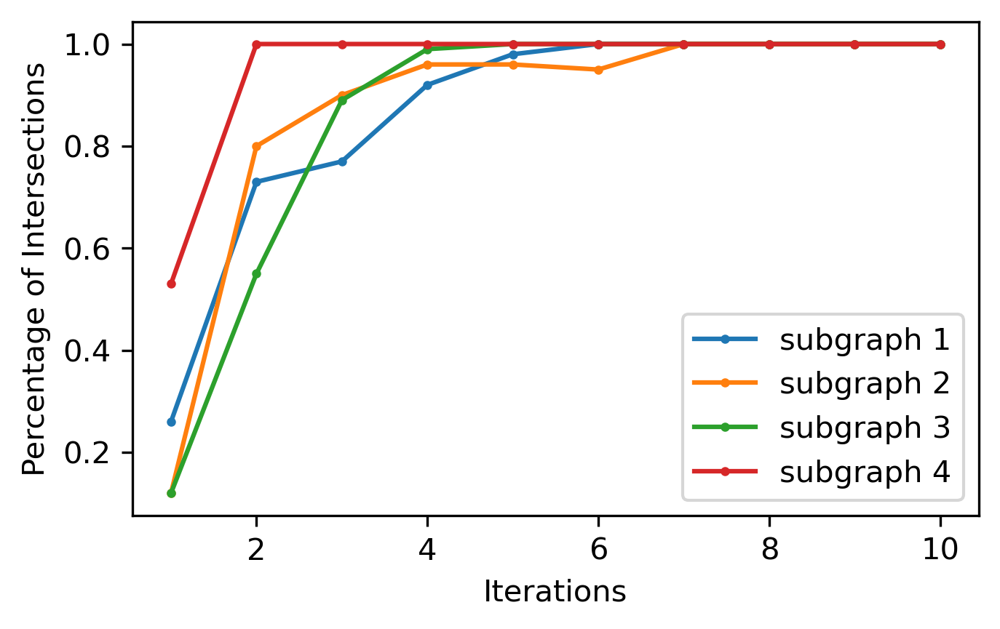

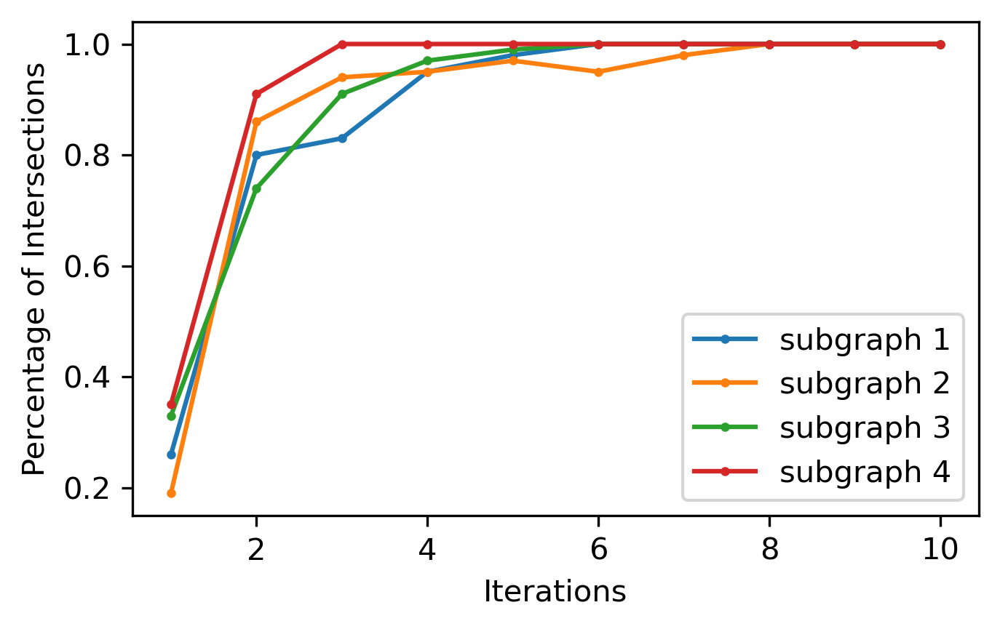

In [3]:
plt.figure(figsize=(5,3),dpi=300)
for i,ls in enumerate(list_sencell_cover):
    plt.plot(1+np.arange(len(ls)),ls,marker='o',markersize=2,label=f'subgraph {i+1}')
    
plt.ylabel("Percentage of Intersections")
plt.xlabel('Iterations')
plt.legend()

plt.figure(figsize=(5,3),dpi=300)
for i,ls in enumerate(list_sengene_cover):
    plt.plot(1+np.arange(len(ls)),ls,marker='o',markersize=2,label=f'subgraph {i+1}')
    
plt.ylabel("Percentage of Intersections")
plt.xlabel('Iterations')
plt.legend()


In [4]:
all_gene_ls

[[[10758,
   10759,
   10764,
   10768,
   10773,
   10777,
   10779,
   10789,
   10790,
   10794,
   10795,
   10799,
   10801,
   10807,
   10809,
   10819,
   10829,
   10758,
   10763,
   10764,
   10769,
   10770,
   10789,
   10790,
   10819,
   10825,
   10833,
   10762,
   10763,
   10797,
   10801,
   10819,
   10823,
   10758,
   10759,
   10767,
   10770,
   10771,
   10779,
   10785,
   10790,
   10799,
   10801,
   10807,
   10819,
   10821,
   10833,
   10758,
   10759,
   10760,
   10765,
   10772,
   10790,
   10807,
   10811,
   10819,
   10833,
   10762,
   10763,
   10767,
   10781,
   10797,
   10801,
   10819,
   10826,
   10763,
   10768,
   10782,
   10789,
   10790,
   10795,
   10797,
   10801,
   10819,
   10826,
   10758,
   10759,
   10760,
   10768,
   10772,
   10779,
   10785,
   10789,
   10790,
   10791,
   10792,
   10794,
   10795,
   10796,
   10801,
   10804,
   10807,
   10809,
   10811,
   10825,
   10833,
   10762,
   10763,
   10768,
   10769,


642
731
1508
1563
185
270
502
1336
1338
1784
344
722
880
981
494
1056
1121
1976
1987
2020
999
260
892
1652
1714
2018
225
528
1920
2174
1127
1082
1418
2035
2030
2024
294
755
211
1569
1117
1804
1951
1991
725
2014
1616
536
1995
419
636
637
500
882
1247
924
284
1214
1318
1264
369
2086
426
1344
571
660
993
347
1815
2004
979
255
266
1622
1295


[2004,
 2116,
 2035,
 2189,
 1995,
 1922,
 2242,
 1996,
 1987,
 1920,
 2244,
 2119,
 2158,
 2201,
 2209,
 2120,
 2182,
 2100,
 2011,
 2018,
 1918,
 2159,
 2147,
 2034,
 2200,
 1948,
 1942,
 2127,
 1972,
 1958,
 2220,
 2226,
 1898,
 2030,
 2020,
 2167,
 2017,
 2207,
 2049,
 2187,
 1962,
 2014,
 2104,
 2230,
 2175,
 2071,
 1976,
 2031,
 2108,
 2174,
 1933,
 2060,
 2010,
 2024,
 1941,
 1967,
 1975,
 2216,
 2086,
 1911,
 1991,
 2192,
 1978,
 2171,
 2025,
 1951,
 2190,
 2169,
 2185,
 2145,
 2223,
 1905,
 2130,
 2044,
 2007,
 2110,
 2131,
 2243]

In [ ]:
markers_index[-1]

In [15]:
def combine_gene(adata,markers_ls):

    markers_set=set(list(markers_ls[0])+list(markers_ls[1])+list(markers_ls[2])+list(markers_ls[3]))
    print('total marker genes: ',len(markers_set))

    highly_genes=list(adata.var[adata.var['vst.variable']==True].index)
    print('highly_genes: ',len(highly_genes))

    # 去除其中的老化基因，然后再把老化基因append到最后
    highly_genes=list(set(highly_genes)-markers_set)
    print('After dropping duplicate: ',len(highly_genes))

    # 这里有要注意的地方，有可能老化基因在所有cell里面都是0表达
    # 所以这里要加一步去除0表达的基因
    sen_gene_ls=[]
    cell_gene=adata.X.toarray()
    gene_names=list(adata.var.index)

    for gene in markers_set:
        if gene in gene_names:
            gene_index=gene_names.index(gene)
            if max(cell_gene[:,gene_index])!=0:
                sen_gene_ls.append(gene)

    # marker name list
    genes=highly_genes+sen_gene_ls
    print('gene number:',len(genes))

    new_data=adata[:,adata.var.index.isin(genes)]

    # 得到每个marker list里面marker的index
    markers_index=[]
    for markers in markers_ls:
        indexs=[]
        for marker in markers:
            if marker in genes:
                indexs.append(genes.index(marker))
        markers_index.append(indexs)
    # 得到markers_index，包含4个list，是marker在genes里面的index
    # 所有marker的index
    sen_gene_ls=np.concatenate(markers_index)
    nonsen_gene_ls=[]
    for i in highly_genes:
        nonsen_gene_ls.append(genes.index(i))

    return new_data,markers_index,sen_gene_ls,nonsen_gene_ls,genes
new_data,markers_index,sen_gene_ls,nonsen_gene_ls,gene_names=combine_gene(adata,markers_ls)

total marker genes:  380
highly_genes:  2000
After dropping duplicate:  1894
gene number: 2245


In [19]:
marker_gene_names=[]
sen_gene_names=[]
for i in markers_index[-1]:
    marker_gene_names.append(gene_names[i])
for i in all_gene_ls[-1][-1]:
    sen_gene_names.append(gene_names[big_graph_index_dict[i]])

In [25]:
set1=set(sen_gene_names).intersection(set(marker_gene_names))

In [26]:
set(sen_gene_names)-set1

{'AC018362.2',
 'ACTG2',
 'AGR2',
 'ASPN',
 'C11orf97',
 'CACNG4',
 'CAMK2N1',
 'CAV2',
 'CD24',
 'CD248',
 'CD52',
 'CDC25C',
 'CFAP206',
 'CFI',
 'CHI3L2',
 'DCN',
 'DEPP1',
 'DHFR',
 'ERG',
 'EYA4',
 'F13A1',
 'FGFR4',
 'FHDC1',
 'FREM1',
 'GATA2-AS1',
 'HMGB2',
 'KCNJ15',
 'KIAA1217',
 'LGALS1',
 'LINC01133',
 'LMO1',
 'LPL',
 'LRRC6',
 'LTB',
 'MACC1',
 'MLF1',
 'MMP11',
 'MSX1',
 'P2RY13',
 'PARD6G',
 'PIEZO2',
 'PIH1D2',
 'PKHD1L1',
 'PLPP2',
 'PRSS23',
 'PTPRG',
 'RCAN2',
 'REM1',
 'ROBO4',
 'SELE',
 'SEMA5A',
 'SPINK5',
 'SRD5A2',
 'TCF4',
 'TMEM190',
 'TNFRSF17',
 'TPSG1',
 'TTC25',
 'UPK3B',
 'ZMYND10'}

In [3]:
from sampling import sub_sampling_by_marker
from sampling import identify_sencell_marker_graph
from sampling import sub_sampling_by_random
from model_Sencell import cell_optim,update_cell_embeddings

from sampling import identify_sengene_by_sencell


all_gene_ls=[]

list_sencell_cover=[]
list_sengene_cover=[]

for ii in range(5):
    sampled_graph,sencell_dict,nonsencell_dict,cell_clusters,big_graph_index_dict,sengene_ls=sub_sampling_by_random(graph_nx,graph,
                                                            sen_gene_ls,
                                                            nonsen_gene_ls,
                                                            GAT_model,
                                                            device,
                                                            gene_num=2245,cell_num=10558,
                                                            gene_rate=0.3,cell_rate=0.5,
                                                            debug=False)

    # print('After sampling, gene num: ',sum(sampled_graph.y))
    # print(sengene_ls)
    sencell_cover=[]
    sengene_cover=[]
    iter_sengene_ls=[]
    
    for _ in range(10):
        # print(sencell_dict,nonsencell_dict)

        sencell_dict,nonsencell_dict=cell_optim(sencell_dict,nonsencell_dict,device)
        # print(sencell_dict,nonsencell_dict)
        sampled_graph=update_cell_embeddings(sampled_graph,sencell_dict,nonsencell_dict)
        old_sencell_dict=sencell_dict
        old_sengene_ls=sengene_ls
        iter_sengene_ls.append(old_sengene_ls)
        sampled_graph,sencell_dict,nonsencell_dict,cell_clusters,big_graph_index_dict,sengene_ls=identify_sengene_by_sencell(sampled_graph,GAT_model,cell_clusters,
                                  big_graph_index_dict,
                                  sencell_dict,
                                  nonsencell_dict,device)
        print('After sampling, gene num: ',sum(sampled_graph.y))


        set1=set(list(old_sencell_dict.keys()))
        set2=set(list(sencell_dict.keys()))
        set3=set1.intersection(set2)
        print('sencell cover:',len(set3)/len(set2))
        sencell_cover.append(len(set3)/len(set2))
        
        set1=set(old_sengene_ls)
        set2=set(sengene_ls)
        set3=set1.intersection(set2)
        print('sengene cover:',len(set3)/len(set2))
        sengene_cover.append(len(set3)/len(set2))
    
    list_sencell_cover.append(sencell_cover)
    list_sengene_cover.append(sengene_cover)
    
    all_gene_ls.append(iter_sengene_ls)

Start sampling subgraph randomly ...
    Sengene num: 50, Nonsengen num: 50
subgraph total node num: (10604,)
After sampling, gene num:  tensor(98)
    Sencell num: 100, Nonsencell num: 900
rechoice sengene num: 50 rechoice nonsengene num: 48
    Sencell num: 100, Nonsencell num: 900
After sampling, gene num:  tensor(98, device='cuda:0')
sencell cover: 0.78
sengene cover: 0.6
rechoice sengene num: 50 rechoice nonsengene num: 48
    Sencell num: 100, Nonsencell num: 900
After sampling, gene num:  tensor(98, device='cuda:0')
sencell cover: 0.98
sengene cover: 0.94
rechoice sengene num: 50 rechoice nonsengene num: 48
    Sencell num: 100, Nonsencell num: 900
After sampling, gene num:  tensor(98, device='cuda:0')
sencell cover: 0.99
sengene cover: 0.98
rechoice sengene num: 50 rechoice nonsengene num: 48
    Sencell num: 100, Nonsencell num: 900
After sampling, gene num:  tensor(98, device='cuda:0')
sencell cover: 1.0
sengene cover: 1.0
rechoice sengene num: 50 rechoice nonsengene num: 48


In [3]:
list_sencell_cover

[[0.55, 0.78, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 [0.56, 0.85, 0.99, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 [0.55, 0.8, 0.74, 0.99, 0.99, 1.0, 1.0, 1.0, 1.0, 1.0],
 [0.37, 0.83, 0.92, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 [0.48, 0.88, 0.95, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]]

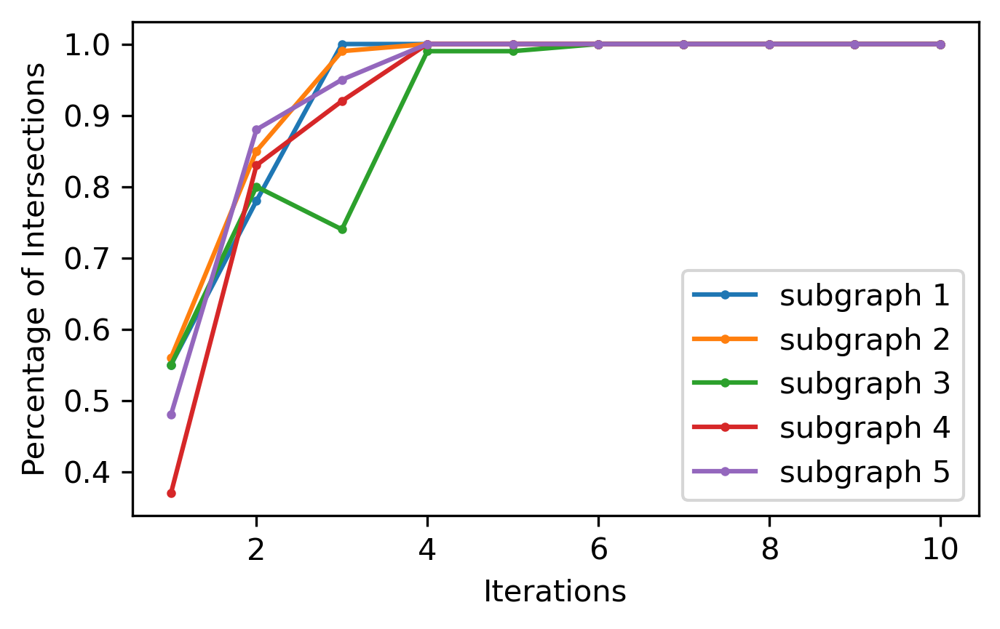

In [4]:
plt.figure(figsize=(5,3),dpi=300)
for i,ls in enumerate(list_sencell_cover):
    plt.plot(1+np.arange(len(ls)),ls,marker='o',markersize=2,label=f'subgraph {i+1}')
    
plt.ylabel("Percentage of Intersections")
plt.xlabel('Iterations')
plt.legend()

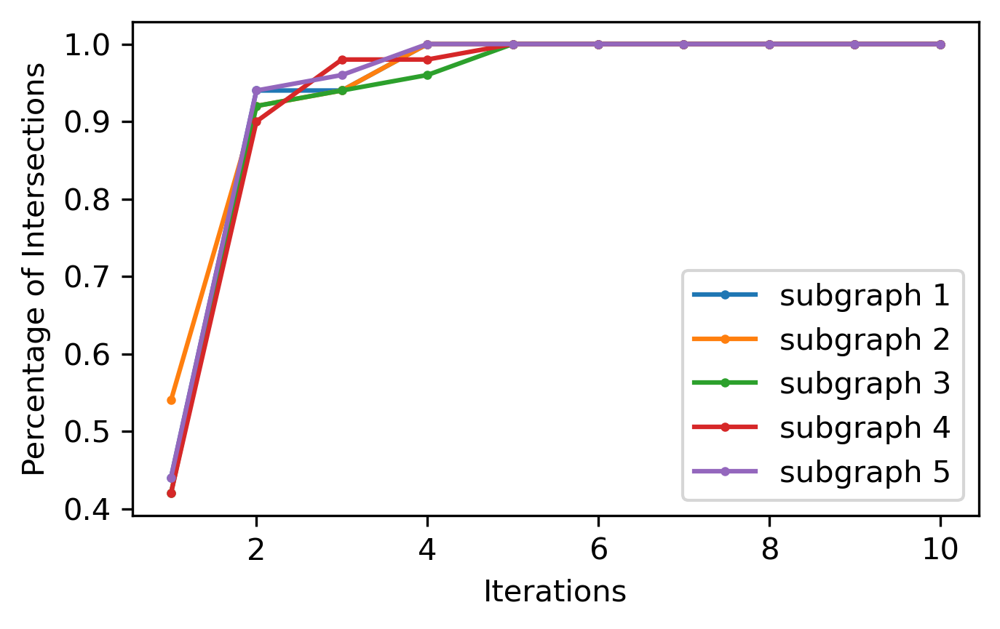

In [5]:
plt.figure(figsize=(5,3),dpi=300)
for i,ls in enumerate(list_sengene_cover):
    plt.plot(1+np.arange(len(ls)),ls,marker='o',markersize=2,label=f'subgraph {i+1}')
    
plt.ylabel("Percentage of Intersections")
plt.xlabel('Iterations')
plt.legend()

In [ ]:
cellmodel=Sencell().to(device)
optimizer = torch.optim.Adam(cellmodel.parameters(), lr=0.001, 
                            weight_decay=1e-3)
# optimizer = torch.optim.RMSprop(cellmodel.parameters(), lr=0.1, alpha=0.5,
#                                 weight_decay=1e-4)

cellmodel.train()

for marker_index in markers_index:
    sampled_graph,cell_clusters,big_graph_index_dict=sub_sampling_by_marker(graph,graph_nx,marker_index)
    sencell_dict,nonsencell_dict=identify_sencell_marker_graph(sampled_graph,GAT_model,
                                                                cell_clusters,
                                                                big_graph_index_dict,
                                                                device)
    for epoch in range(20):
        optimizer.zero_grad()
        print(cellmodel.levels)
        sencell_dict,nonsencell_dict = cellmodel(sencell_dict,nonsencell_dict,device)
        loss=cellmodel.loss(sencell_dict,nonsencell_dict)
        print(loss)
        loss.backward()
        optimizer.step()
        torch.save(cellmodel,'./cellmodel.pt')

subgraph total node num: (10641,)
sencell_num: 100
Parameter containing:
tensor([0.0000, 1.2500, 0.7500, 2.0000], device='cuda:0', requires_grad=True)
tensor([0.0194], device='cuda:0', grad_fn=<NormBackward1>) tensor(0., device='cuda:0', grad_fn=<SelectBackward>)
tensor([0.0675], device='cuda:0', grad_fn=<NormBackward1>) tensor(0., device='cuda:0', grad_fn=<SelectBackward>)
tensor([0.0210], device='cuda:0', grad_fn=<NormBackward1>) tensor(0., device='cuda:0', grad_fn=<SelectBackward>)
tensor([0.0755], device='cuda:0', grad_fn=<NormBackward1>) tensor(0., device='cuda:0', grad_fn=<SelectBackward>)
tensor([0.0545], device='cuda:0', grad_fn=<NormBackward1>) tensor(0., device='cuda:0', grad_fn=<SelectBackward>)
tensor([0.0361], device='cuda:0', grad_fn=<NormBackward1>) tensor(0., device='cuda:0', grad_fn=<SelectBackward>)
tensor([0.0396], device='cuda:0', grad_fn=<NormBackward1>) tensor(0., device='cuda:0', grad_fn=<SelectBackward>)
tensor([0.0234], device='cuda:0', grad_fn=<NormBackward1>)

ERROR! Session/line number was not unique in database. History logging moved to new session 375


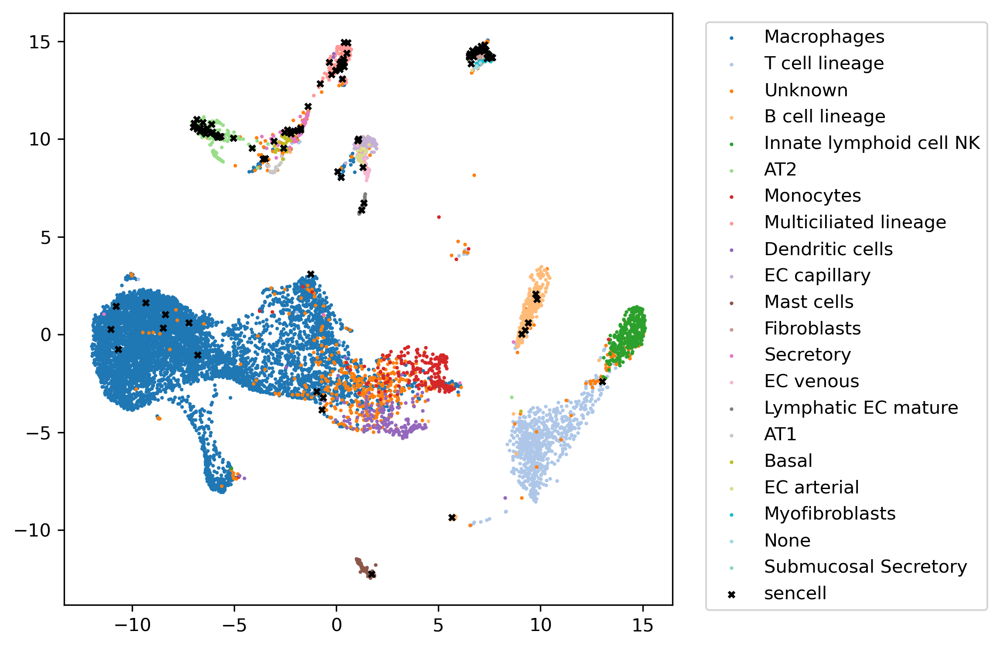

In [29]:
from plots import plot_distance,plot_umap2
gene_num=new_data.shape[1]
plot_umap2(adata,sencell_dict,nonsencell_dict,gene_num,
           cell_cluster_indexs)

In [9]:
np.random.choice(np.arange(10),20,replace=False)

ValueError: Cannot take a larger sample than population when 'replace=False'

rechoice sengene num: 50 rechoice nonsengene num: 50
    Sencell num: 100, Nonsencell num: 900


In [15]:
sum(sampled_graph.y)

tensor(99, device='cuda:0')

subgraph total node num: (10239,)
sencell_num: 100


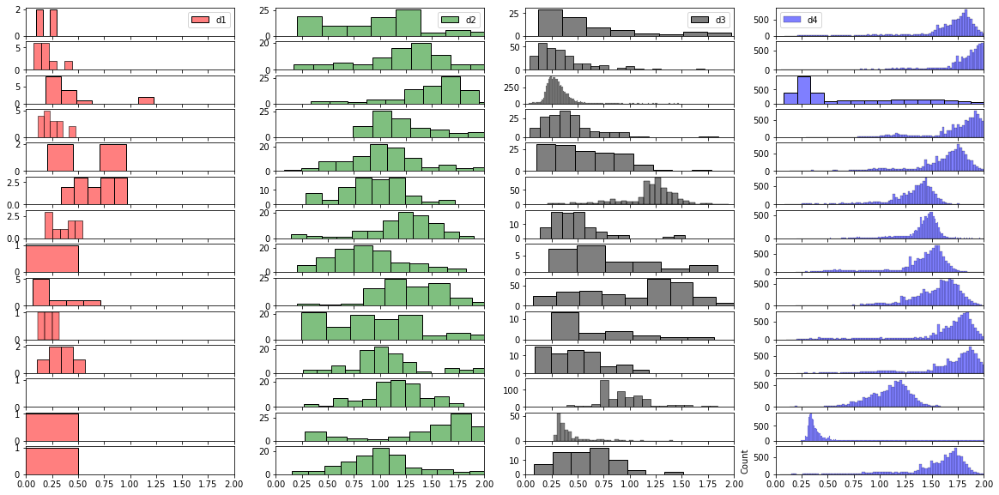

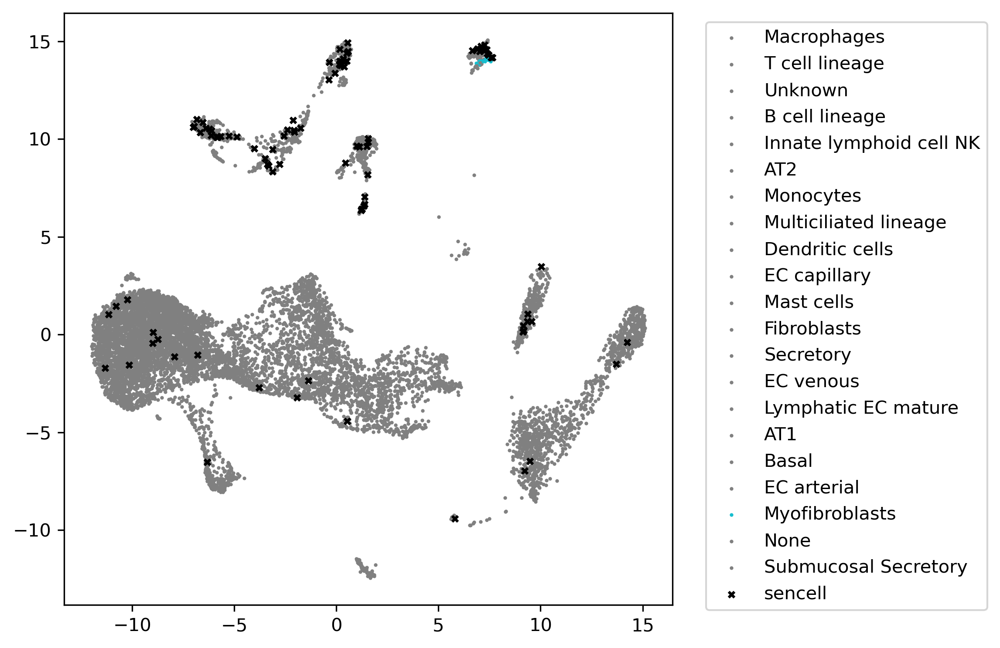

In [2]:
# Part 4, sencell optimization

from sampling import sub_sampling_by_marker
from sampling import identify_sencell_marker_graph
from sampling import sub_sampling_by_random

from plots import plot_distance,plot_umap2

cellmodel=torch.load("./cellmodel.pt")
cellmodel.eval()
gene_num=new_data.shape[1]

for marker_index in markers_index:
    sampled_graph,cell_clusters,big_graph_index_dict=sub_sampling_by_marker(graph,graph_nx,marker_index)
    sencell_dict,nonsencell_dict=identify_sencell_marker_graph(sampled_graph,GAT_model,
                                                                cell_clusters,
                                                                big_graph_index_dict,
                                                                device)
    sencell_dict,nonsencell_dict = cellmodel(sencell_dict,nonsencell_dict,device)
    plot_distance(sencell_dict,nonsencell_dict,emb_pos=2)
    plot_umap2(adata,sencell_dict,nonsencell_dict,gene_num,
               cell_cluster_indexs)
    break

In [3]:
from sampling import select_cell_by_genes

def identify_sengene_sencell_marker_graph(sampled_graph,model,cell_clusters,
                                  big_graph_index_dict,
                                  sencell_dict,
                                  nonsencell_dict,
                                  ratio=0.1,plot=False):
    # 这个函数里面首先会先识别老化基因
    # 然后再识别老化细胞
    # cell_clusters: tensor
    
    # step 1: get embedding and attention
    model.eval()
    model.to(device)
    sampled_graph.to(device)
    # edge_att: nx1
    # 注意这里的的edge是双向边
    # 对应的edge_att也是双向边的权重，而且二者不一定相同
    # 这里edge表示(source,target)
    # 所以一个target节点与所有source节点之间边attention之和为1
    # 所以这里找老化细胞考虑的cell score是以gene为target, cell score是其出现过的所有attention之和
    z,(edge,edge_att)=model.encoder.get_att(sampled_graph)
    att=edge_att.T[0].detach().cpu()
    z=z.detach().cpu()
    
    # step 2: 识别老化基因
    sencell_indexs=list(sencell_dict.keys())
    nonsencell_indexs=list(nonsencell_dict.keys())
    
    # 为每一个sencell所连接的基因赋予attention权重
    # 这里面存储与sencell所相连的gene（key）和attention权重（value）
    sen_gene_dict={}
    for sencell_index in sencell_indexs:
        candidate_genes=edge[0][edge[1]==sencell_index]
        candidate_genes_atts=att[edge[1]==sencell_index]
        for candidate_gene,candidate_genes_att in zip(candidate_genes,candidate_genes_atts):
            sen_gene_dict[int(candidate_gene)]=sen_gene_dict.get(int(candidate_gene),0)+candidate_genes_att
    
    # 为每一个nonsencell所连接的基因赋予attention权重
    # 这里面存储与nonsencell所相连的gene（key）和attention权重（value）
    nonsen_gene_dict={}
    for nonsencell_index in nonsencell_indexs:
        candidate_genes=edge[0][edge[1]==nonsencell_index]
        candidate_genes_atts=att[edge[1]==nonsencell_index]
        for candidate_gene,candidate_genes_att in zip(candidate_genes,candidate_genes_atts):
            nonsen_gene_dict[int(candidate_gene)]=nonsen_gene_dict.get(int(candidate_gene),0)+candidate_genes_att
    
    
    # 依据att从小到大
    sen_gene_ls=[k for k, v in sorted(sen_gene_dict.items(), key=lambda item: item[1])]
    # 因为这个图上的基因全是老化基因的marker，所以这里只能删除，不能增加
    # 先看一下这里的marker改变如何
    sen_gene_ls=sen_gene_ls[-50:]
    print('rechoice sengene num:',len(sen_gene_ls))
    print(sen_gene_ls)
    
    # 依据att从小到大
    nonsen_gene_ls=[k for k, v in sorted(nonsen_gene_dict.items(), key=lambda item: item[1])]
    # 因为这个图上的基因全是老化基因的marker，所以这里只能删除，不能增加
    # 先看一下这里的marker改变如何
    nonsen_gene_ls=nonsen_gene_ls[-50:]
    print('rechoice nonsengene num:',len(nonsen_gene_ls))
    print(nonsen_gene_ls)
    
    # step 3: 选出来老化基因之后，重新选老化细胞和非老化细胞
    sampled_graph,sencell_dict,nonsencell_dict=select_cell_by_genes(sampled_graph,
                                     sen_gene_ls,nonsen_gene_ls,
                                     cell_clusters,
                                     big_graph_index_dict,
                                     model,device)
    return sampled_graph,sencell_dict,nonsencell_dict



def train_Sencell_random(graph_nx,graph,
                  sen_gene_ls,
                  nonsen_gene_ls,
                  model_GAT,
                  markers_index,device):

    sampled_graph,sencell_dict,nonsencell_dict,cell_clusters,big_graph_index_dict=sub_sampling_by_random(graph_nx,graph,
                                                        sen_gene_ls,
                                                        nonsen_gene_ls,
                                                        model_GAT,
                                                        device,
                                                        gene_num=2245,cell_num=10558,
                                                        gene_rate=0.3,cell_rate=0.5,
                                                        debug=False)

    print(len(sencell_dict),len(nonsencell_dict))
    
    cellmodel=Sencell().to(device)
    optimizer = torch.optim.Adam(cellmodel.parameters(), lr=0.001, 
                                weight_decay=1e-3)
    # optimizer = torch.optim.RMSprop(cellmodel.parameters(), lr=0.1, alpha=0.5,
    #                                 weight_decay=1e-4)

#     cellmodel.train()
#     for epoch in range(20):
#         optimizer.zero_grad()
#         print(cellmodel.levels)
#         sencell_dict,nonsencell_dict = cellmodel(sencell_dict,nonsencell_dict,device)
#         loss=cellmodel.loss(sencell_dict,nonsencell_dict)
#         print(loss)
#         loss.backward()
#         optimizer.step()
        
#     torch.save(cellmodel,'./cellmodel.pt')
    cellmodel=torch.load("./cellmodel.pt")
    # update sampled graph embedding
    sencell_dict,nonsencell_dict = cellmodel(sencell_dict,nonsencell_dict,device)
    sampled_graph=sampled_graph.to('cpu')
    feature=sampled_graph.x
    
    for key,value in sencell_dict.items():
        feature[key]=value[2].detach().cpu()

    for key,value in nonsencell_dict.items():
        feature[key]=value[2].detach().cpu()
    sampled_graph.x=feature
    
    sampled_graph,sencell_dict,nonsencell_dict=identify_sengene_sencell_marker_graph(sampled_graph,GAT_model,cell_clusters,
                                  big_graph_index_dict,
                                  sencell_dict,
                                  nonsencell_dict,
                                  ratio=0.1,plot=False)
    return sampled_graph
    

sampled_graph=train_Sencell_random(graph_nx,graph, sen_gene_ls,nonsen_gene_ls,
                     GAT_model, 
                     markers_index,device)

subgraph total node num: (10489,)
100 900
rechoice sengene num: 50
[10442, 10410, 10474, 10480, 0, 10458, 10466, 10481, 10476, 10486, 10404, 10443, 10420, 10467, 6701, 10473, 10470, 10436, 10424, 10434, 10427, 10472, 10451, 10437, 10446, 10411, 10405, 10403, 10426, 10444, 10412, 10471, 10461, 10441, 10463, 10468, 10462, 10475, 10438, 10452, 10428, 10417, 10421, 10435, 10400, 10459, 10402, 10439, 10457, 10445]
rechoice nonsengene num: 50
[10474, 10431, 9824, 10055, 0, 10470, 10424, 10461, 10454, 10416, 10411, 10463, 10473, 10436, 10429, 10248, 10476, 10403, 10437, 10418, 10422, 10427, 10412, 6694, 10451, 10405, 10452, 10420, 6701, 10441, 10472, 10410, 10426, 10404, 10462, 10450, 10414, 10434, 10475, 10421, 10417, 10435, 10428, 10457, 10400, 10438, 10402, 10445, 10439, 10459]


In [4]:
sampled_graph

Data(x=[10489, 128], edge_index=[2, 163134], y=[10489])

In [5]:
sampled_graph

Data(x=[10489, 128], edge_index=[2, 163134], y=[10489])

In [6]:
int(torch.tensor(10077, device='cuda:0'))

10077

In [7]:
sen_gene_ls,nonsen_gene_ls

(array([2131, 2162, 2201, 1904, 2207, 2159, 2066, 1913, 2160, 2002, 2216,
        1921, 2185, 2121, 1908, 1917, 2057, 2152, 2227, 1973, 2192, 2219,
        1984, 2075, 1982, 2170, 2199, 2234, 2157, 2188, 2125, 2112, 1960,
        2233, 1974, 2021, 1979, 2235, 1977, 1910, 2229, 1947, 2168, 2184,
        1939, 2029, 2161, 1940, 1929, 1934, 2020, 1998, 2095, 1938, 1933,
        2181, 2205, 2076, 2231, 2022, 2104, 1902, 2189, 2010, 2109, 2123,
        1972, 2230, 2178, 2130, 2113, 2124, 1936, 2105, 1907, 2197, 2063,
        2172, 1951, 2127, 2040, 1925, 2044, 2025, 2128, 2036, 2045, 2135,
        1948, 1906, 1895, 2077, 2190, 2083, 2133, 1937, 2011, 1927, 2220,
        2030, 2193, 1983, 2084, 1986, 2176, 2173, 1912, 2232, 2242, 2078,
        2215, 2039, 2117, 1989, 2005, 2212, 2086, 2139, 2088, 2065, 2240,
        2171, 1914, 2061, 2047, 2046, 1930, 2059, 2210, 2009, 1900, 1952,
        2229, 1909, 2069, 1976, 1928, 1962, 2118, 2016, 1931, 2114, 2202,
        2100, 1933, 2181, 2205, 2076, 